# Estimate the historic mining area of a single mine

In this notebook, the sam-geo model will be used to analyze the historic mining area of a single mine. 

### TODOs: 
- [ ] Plot sentinel images and masks yearly
- [ ] Add metadata (year) and different colors to polygons displayed on map
- [ ] Plot the area for each year
- [ ] Regularize very small polygons (?) 
- [ ] Test with landsat images as well to have larger timewindow
- [ ] Use segmentation polygon as input for previous year

In [1]:
# !pip install segment-geospatial

In [2]:
import sys
sys.path.append("..")

from samgeo import SamGeo
import leafmap
from matplotlib.pyplot import cm

from src.data.get_satellite_images import ReadSTAC

In [3]:
MINE_POINT = [-50.16556135114535, -6.060451692157381]
BUFFER = 5
YEARS = list(range(1985, 2021, 5))
print(YEARS)

[1985, 1990, 1995, 2000, 2005, 2010, 2015, 2020]


In [4]:
# Option 1 (Default): Read from Planetary Computer STAC API
api_url="https://planetarycomputer.microsoft.com/api/stac/v1"
bands = ['B04', 'B03', 'B02']
bands_landsat = ['red', 'green', 'blue']

# Option 2: Read from AWS STAC API
# api_url="https://earth-search.aws.element84.com/v1"
# bands = ['red', 'green', 'blue']

stac_reader = ReadSTAC(api_url=api_url, collection="landsat-c2-l2")

In [50]:
# Docs: https://samgeo.gishub.org/samgeo/#samgeo.samgeo.SamGeo.__init__
sam = SamGeo(
    model_type="vit_l", # vit_l (2.4GB), vit_h (1.2GB), vit_b(~300MB)
    automatic=False,
    # device="cuda",
    sam_kwargs=None,
)

Model checkpoint for vit_l not found.


Downloading...
From: https://dl.fbaipublicfiles.com/segment_anything/sam_vit_l_0b3195.pth
To: /root/.cache/torch/hub/checkpoints/sam_vit_l_0b3195.pth
100%|██████████| 1.25G/1.25G [05:45<00:00, 3.62MB/s]


# Optional: Use bounding box instead of point as prompt for SAM

In [6]:
# initiazlize leafmap and optionally draw a bounding box
m = leafmap.Map(center = [MINE_POINT[1], MINE_POINT[0]], zoom = 13, height="800px")
m.add_basemap("SATELLITE")
m

Map(center=[-6.060451692157381, -50.16556135114535], controls=(ZoomControl(options=['position', 'zoom_in_text'…

In [7]:
if m.user_rois is not None:
    sam_prompt_box = m.user_rois
    sam_prompt_point = None
else: 
    sam_prompt_box = None
    sam_prompt_point = [MINE_POINT]

print("Prompt Box:", sam_prompt_box)
print("Prompt Point:", sam_prompt_point)

Prompt Box: {'type': 'FeatureCollection', 'features': [{'type': 'Feature', 'properties': {}, 'geometry': {'type': 'Polygon', 'coordinates': [[[-50.206146, -6.120927], [-50.206146, -6.018507], [-50.102463, -6.018507], [-50.102463, -6.120927], [-50.206146, -6.120927]]]}}]}
Prompt Point: None


In [51]:
for year in YEARS:
    print(f"Year: {year}")

    # check available items
    items = stac_reader.get_items(
        location = MINE_POINT,
        buffer=10,
        timerange=f'{year}-01-01/{year}-12-31',
        max_cloud_cover=10
    )

    # download least cloudy image
    stack = stac_reader.get_stack(
        items, 
        filter_by="least_cloudy", 
        take_best_n=3,
        bands=bands_landsat, 
        resolution=30
        )
    
    stack_stretched = stac_reader.stretch_contrast_stack(stack)
    image_path = stac_reader.save_stack_as_geotiff(stack_stretched, f"{year}.tif")

    # provide image to samgeo
    sam.set_image(image_path)

    # create output file path for mask
    mask_path = image_path.replace(".tif", "_mask.tif")

    # predict mask
    sam.predict(
        point_coords=sam_prompt_point,
        boxes=sam_prompt_box, 
        point_labels=1, 
        point_crs="EPSG:4326", 
        output=mask_path
    )

    # convert mask to polygons
    mask_polygon_path = mask_path.replace(".tif", ".gpkg")
    sam.raster_to_vector(mask_path, mask_polygon_path)

    # add mask to map
    style = {
        "color": "#3388ff",
        "weight": 2,
        "fillColor": "#7c4185",
        "fillOpacity": 0.5,
    }
    m.add_vector(mask_polygon_path, layer_name=f"{year} Mask", style=style)


Year: 1985
2 Items found.
Loading stack...
Found 1 unique tile ids.
Choosing the best 3 items.For unique tile 224_064, choosing ['LT05_L2SP_224064_19850227_02_T2', 'LT05_L2SP_224064_19850518_02_T2'] from [datetime.date(1985, 2, 27), datetime.date(1985, 5, 18)] with [0.0, 7.0]% cloud cover
Stretching contrast...
Saving stack as GeoTIFF under: /workspaces/mine-segmentation/data/interim/1985.tif
Year: 1990
2 Items found.
Loading stack...
Found 1 unique tile ids.
Choosing the best 3 items.For unique tile 224_064, choosing ['LT05_L2SP_224064_19900601_02_T1', 'LT05_L2SP_224064_19900804_02_T1'] from [datetime.date(1990, 6, 1), datetime.date(1990, 8, 4)] with [7.0, 8.0]% cloud cover
Stretching contrast...
Saving stack as GeoTIFF under: /workspaces/mine-segmentation/data/interim/1990.tif
Year: 1995
2 Items found.
Loading stack...
Found 1 unique tile ids.
Choosing the best 3 items.For unique tile 224_064, choosing ['LT05_L2SP_224064_19950701_02_T1', 'LT05_L2SP_224064_19950802_02_T1'] from [datet

In [9]:
# display the map
m

Map(bottom=1084347.0, center=[-6.060451692157381, -50.16556135114535], controls=(ZoomControl(options=['positio…

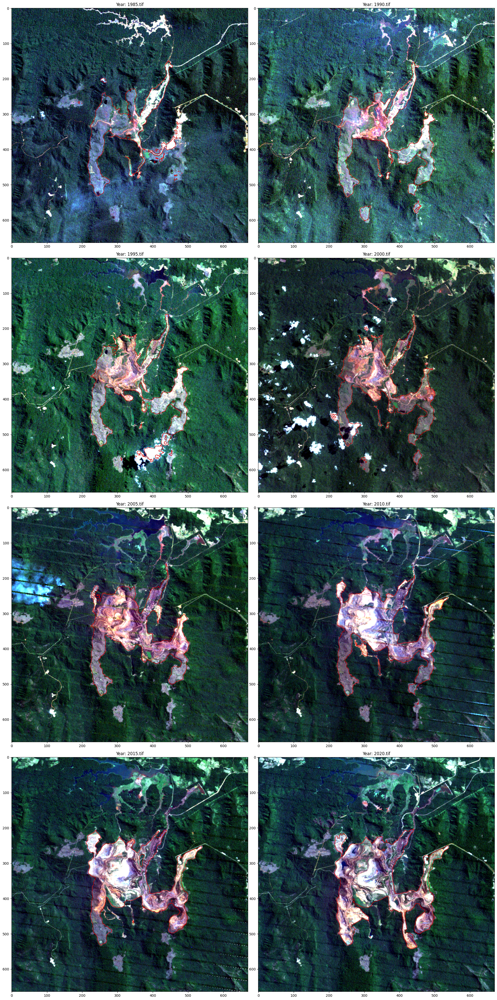

In [54]:
# Plot the masks
import glob
import matplotlib.pyplot as plt
import os
import rasterio
import numpy as np
import scipy.ndimage

mask_files = glob.glob('/workspaces/mine-segmentation/data/interim/*_mask.tif')

# Find all files ending with .tif in the folder data/interim
# and filter out files that contain "mask" in their name
image_files = glob.glob('/workspaces/mine-segmentation/data/interim/*.tif')
image_files = [file for file in image_files if "mask" not in file]

def plot_multiple_images(image_files, mask_files):
    # Ensure that the image_files and mask_files lists have the same length
    assert len(image_files) == len(mask_files), "The number of image files and mask files must be the same."

    # Calculate the number of rows and columns for the grid
    num_images = len(image_files)
    num_cols = min(num_images, 2)  # Maximum 2 images per row
    num_rows = (num_images + num_cols - 1) // num_cols  # Round up to the nearest integer

    # Create a figure
    fig = plt.figure(figsize=(10 * num_cols, 10 * num_rows))

    # Iterate over the image and mask files
    for i, (image_file, mask_file) in enumerate(zip(image_files, mask_files)):
        # Create a subplot
        ax = fig.add_subplot(num_rows, num_cols, i + 1)

        # Plot the mask on the image
        plot_mask_on_image(image_file, mask_file, ax)

    plt.tight_layout()
    plt.show()

def plot_mask_on_image(image_path, mask_path, ax):
    
    # Plot the image
    image = plt.imread(image_path)
    plt.imshow(image)

    # Open and read the mask
    with rasterio.open(mask_path) as src:
        mask = src.read(1)
    mask = np.where(mask > 0, 1, 0)  # Convert the mask to binary

    # Create a square-shaped structure element
    structure = np.ones((3, 3))

    # Erode the mask and subtract it from the original mask to get the outline
    eroded_mask = scipy.ndimage.binary_erosion(mask, structure)
    outline = mask - eroded_mask

    # Create a new RGBA image
    rgba = np.zeros((outline.shape[0], outline.shape[1], 4))  # 4 for RGBA

    # Set the red channel to the outline
    rgba[..., 0] = outline

    # Set the alpha channel to the outline
    rgba[..., 3] = outline

    # Plot the RGBA image
    ax.imshow(rgba)

    # Extract the year from the image file name and set it as the title
    year = os.path.basename(image_path).split('_')[0]  # Change this line if the year is located differently in the file name
    ax.set_title(f'Year: {year}')

plot_multiple_images(image_files, mask_files)

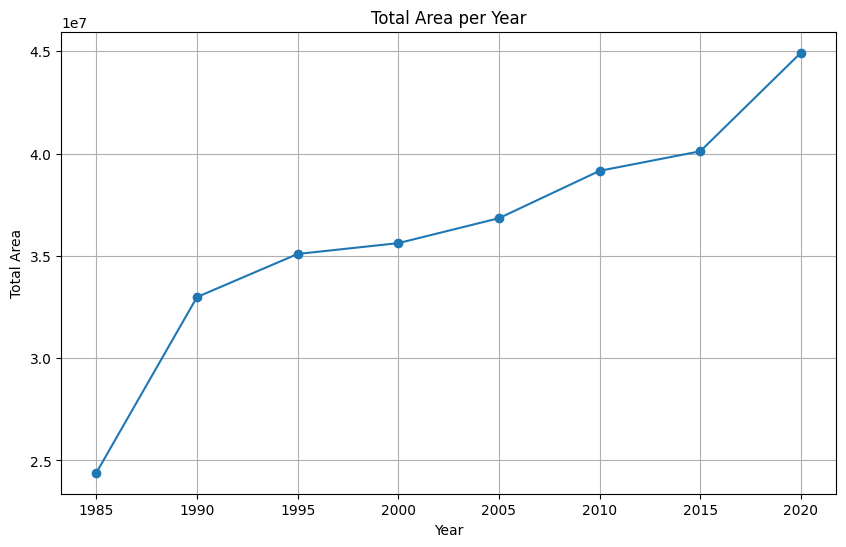

In [56]:
import geopandas as gpd

gpkg_files = glob.glob('/workspaces/mine-segmentation/data/interim/*.gpkg')

def plot_area_per_year(gpkg_files):
    # Initialize a list to store the total area for each year
    areas = []

    # Iterate over the .gpkg files
    for gpkg_file in gpkg_files:
        # Read the polygons from the .gpkg file
        polygons = gpd.read_file(gpkg_file)

        # Calculate the area of each polygon and sum them up
        total_area = polygons.area.sum()

        # Append the total area to the list
        areas.append(total_area)

    # Extract the years from the file names
    years = [os.path.basename(gpkg_file).split('_')[0] for gpkg_file in gpkg_files]  # Change this line if the year is located differently in the file name

    # Plot the total area per year
    plt.figure(figsize=(10, 6))
    plt.plot(years, areas, marker='o')
    plt.xlabel('Year')
    plt.ylabel('Total Area')
    plt.title('Total Area per Year')
    plt.grid(True)
    plt.show()

plot_area_per_year(gpkg_files)